# SimCLR with Graph-based segmentation

This notebook is part of the field boundary detection project. The goal is to evaluate the algorithm using 2D time series of the same h3 hex AND semi-supervised contrastive learning with Graph-based segmentation.

## Summary
[1. Data Processing](#data_processing)

[2. Model Training](#model_training)

[3. Graph Based Segmenation](#graphbased_segmentation)

## Load required libraries

In [1]:
import sys

# Install packages required only once
install_packages = False

if install_packages:
    !{sys.executable} -m pip install sklearn
    !{sys.executable} -m pip install seaborn

In [2]:
import math
import matplotlib.pyplot as plt
from matplotlib import pyplot

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import seaborn.objects as so
import seaborn as sns

import pandas as pd
import numpy as np

import folium
import h3

## Hyper-parameters and other constants

In [3]:
temporal_samples = 15
band_features = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12']

width = 30 # output vector size
temperature = 0.1 # empirical temperature value

steps_per_epoch = 10
AUTOTUNE = tf.data.AUTOTUNE
shuffle_buffer = 5
num_epochs = 500

queue_size = 10000
kernel_size = 3
strides = 1

# Stronger augmentations for contrastive, weaker ones for supervised training
contrastive_augmentation = {"jitter": 0.3}
classification_augmentation = {"jitter": 0.1}

<a id='data_processing'></a>

# 1. Data Processing

<div>
<img border="5px" src="../res/dataprocessing.png" width="1000"/>
</div>

## Configure the train and test datasets

In [4]:
from pathlib import Path

positive_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\positive_samples\\hex_index_L3=8348b3fffffffff')
negative_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\negative_samples\\hex_index_L3=8348b3fffffffff')

## Load all parquet files from the configured folder

In [5]:
df_positive = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in positive_samples_folder.rglob('*.parquet')
         )

df_negative = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in negative_samples_folder.rglob('*.parquet'))

print('The shape of loaded positive dataframe is:', df_positive.shape)
print('The shape of loaded negative dataframe is:', df_negative.shape)

df_positive = df_positive.drop_duplicates()
df_negative = df_negative.drop_duplicates()

df_positive['timestamp'] = df_positive.scene_id.str[11:26]
df_negative['timestamp'] = df_negative.scene_id.str[11:26]

print('The shape of loaded positive dataframe is:', df_positive.shape)
print('The shape of loaded negative dataframe is:', df_negative.shape)

display(df_positive.head(5))
display(df_negative.head(5))


The shape of loaded positive dataframe is: (98148, 19)
The shape of loaded negative dataframe is: (74163, 19)
The shape of loaded positive dataframe is: (98148, 20)
The shape of loaded negative dataframe is: (74163, 20)


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,521.0,536.0,1036.0,634.0,1486.0,3316.0,3837.0,3984.0,4040.0,3963.0,2649.0,1518.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c17ff,4,14RPQ,521.0,537.0,1036.0,638.0,1504.0,3390.0,3843.0,3842.0,4074.0,3963.0,2607.0,1495.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c23ff,4,14RPQ,527.0,565.0,849.0,753.0,1390.0,2555.0,2796.0,2536.0,3128.0,3746.0,2583.0,1605.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c27ff,4,14RPQ,556.0,509.0,979.0,736.0,1462.0,2922.0,3187.0,3292.0,3500.0,3856.0,2598.0,1540.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c31ff,4,14RPQ,527.0,536.0,1011.0,660.0,1512.0,3284.0,3733.0,3654.0,3985.0,3746.0,2603.0,1538.0,20181029T170421


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c01ff,5,14RPQ,888.0,1034.0,1458.0,1546.0,1956.0,3277.0,3696.0,4004.0,3844.0,3662.0,3317.0,2241.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c03ff,4,14RPQ,888.0,934.0,1272.0,1340.0,1669.0,2765.0,3081.0,2800.0,3364.0,3662.0,2883.0,1914.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c05ff,4,14RPQ,888.0,1042.0,1458.0,1552.0,1903.0,3050.0,3344.0,3124.0,3636.0,3662.0,3379.0,2425.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c07ff,4,14RPQ,888.0,956.0,1256.0,1370.0,1643.0,2492.0,2738.0,2832.0,3076.0,3662.0,2916.0,2007.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c0bff,4,14RPQ,760.0,916.0,1368.0,1090.0,1844.0,3406.0,3768.0,4232.0,4069.0,3958.0,3155.0,1978.0,20181029T170421


## Unique fields in the dataset

In [6]:
print(df_positive.FIELD_OPERATION_GUID.unique())

<StringArray>
['1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24',
 '19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17',
 '48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16',
 '492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14',
 '8300721c-a085-4fc0-8520-763f1db45406 2019-02-23',
 '92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16',
 'ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16',
 'c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25',
 'c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25',
 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17',
 'ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24',
 'f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16',
 '2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24',
 '76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24',
 'a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02',
 '06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02',
 'a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02']
Length: 17, dtype: string


## Remove hexes that are represented in both positive and negative datasets

In [7]:
print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

positive_l12_hexes = df_positive.hex.unique()
negative_l12_hexes = df_negative.hex.unique()

ambiguous_l12_hexes = set(positive_l12_hexes).intersection(negative_l12_hexes)
print('There are ', len(ambiguous_l12_hexes), ' hexes labeled both as positive and negative')

df_positive = df_positive[~df_positive['hex'].isin(ambiguous_l12_hexes)]
df_negative = df_negative[~df_negative['hex'].isin(ambiguous_l12_hexes)]

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

In this dataset there are  4939  different positive hexes
In this dataset there are  3772  different negative hexes
There are  184  hexes labeled both as positive and negative
In this dataset there are  4755  different positive hexes
In this dataset there are  3588  different negative hexes


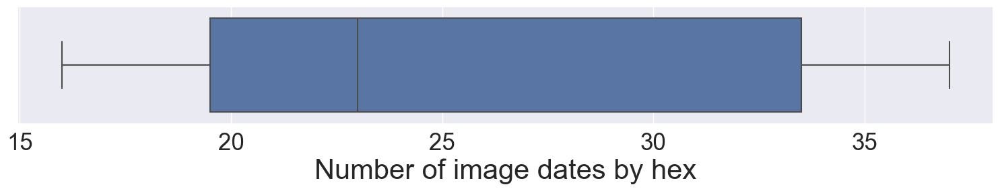

In [8]:
sns.set(rc={'figure.figsize':(18.7,2.27)})

temporal_samples_count = df_positive.groupby(['hex'])['hex'].count()

hist = pd.DataFrame(temporal_samples_count) \
        .rename(columns={'hex': 'count'}) \
        .reset_index(level=0) \
        .groupby(['count'])['count'].count()

hist_df = pd.DataFrame(hist) \
          .rename(columns={'count': 'frequency'}) \
          .reset_index(level=0)

#so.Plot(hist_df["count"], hist_df["frequency"]) \
#    .add(so.Bar()) \
#    .scale(x=so.Continuous().tick(every=2)) \
#    .layout(size=(10, 4))

ax = sns.boxplot(x=hist_df["count"])

ax.set_xlabel("Number of image dates by hex",fontsize=30)
ax.tick_params(labelsize=25)



## Sentinel 2 bands
These are the 12 bands contained in the parque files and their respective meanings

<div>
<img src="../res/sentinel2-bands.png" width="500"/>
</div>

## Show some of the L12 hexes loaded in the folium map

In [9]:
if False:
    # Drop hexes from non-conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')

    df_negative = df_negative[~df_negative['hex'].isin(drop_list)]
    df_positive = df_positive[~df_positive['hex'].isin(drop_list)]
    
    # Treat false negatives
    false_negatives = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)

    print(sum(df_negative.label==1), sum(df_negative.label==0))
    
    df_negative = df_negative.reset_index()
    df_positive = df_positive.reset_index()
    # Assign to negatives recognized as false the label 1
    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1
    
    print(sum(df_negative.label==1), sum(df_negative.label==0))

    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)

In [10]:
for index, f in enumerate(df_positive.FIELD_OPERATION_GUID.unique()):
    print('F{:02d}'.format(index+1) +
          '&'+
          f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.nunique():,}' +
          '&'+
          f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.nunique()}' +
          '&'+
          f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.count():,}' +
          '&'+
          f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.count():,}' +
          '&'+
          '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().mean()) +
          '&'+
          '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().std()) +
          '\\\\'
         )


F01&583&299&10,294&5,091&17.66&0.50\\
F02&624&287&12,131&5,481&19.44&0.73\\
F03&59&85&1,075&1,528&18.22&0.65\\
F04&347&232&8,274&5,414&23.84&0.38\\
F05&116&168&2,765&3,788&23.84&1.00\\
F06&191&157&3,352&2,691&17.55&0.59\\
F07&479&308&10,747&6,648&22.44&0.75\\
F08&418&275&8,444&5,430&20.20&0.90\\
F09&183&190&3,727&3,853&20.37&0.70\\
F10&372&275&7,014&5,021&18.85&0.50\\
F11&159&165&3,336&3,463&20.98&0.50\\
F12&103&140&1,926&2,558&18.70&0.50\\
F13&109&170&2,363&3,652&21.68&0.47\\
F14&322&235&5,703&4,165&17.71&0.46\\
F15&408&253&8,117&4,986&19.89&0.67\\
F16&173&203&3,233&3,673&18.69&0.62\\
F17&126&191&2,322&3,408&18.43&0.72\\


In [11]:
h3_hex = h3.h3_to_parent(df_positive.iloc[0]['hex'], 3)

center = h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)

hexes_to_print=500000

df_positive_single_hex = df_positive.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)
df_negative_single_hex = df_negative.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                zoom_start=17,
                overlay = False,
                control = True)

# Print h3 hex
geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)]}
geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'white', 'color': 'white', 'weight': 0.5})
geo_j.add_to(m)

# Print positive samples
for index, row in df_positive_single_hex.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'yellow', 'color': 'green', 'weight': 0.5})
    folium.Popup(
        "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
        ).add_to(geo_j)
    geo_j.add_to(m)

# Print negative samples
for index, row in df_negative_single_hex.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'black', 'weight': 0.5})
    #folium.Popup(str(row['hex'])).add_to(geo_j)
    folium.Popup(
        "<a href='http://127.0.0.1:5000/?action=false_negatives&hex=" + str(row['hex']) + "' target='_blank'>False_negative</a><br/><br/>" +
        "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
        ).add_to(geo_j)
    geo_j.add_to(m)

m.save("index.html")
m

# Visualize the samples in the space reduced to 2 dimensions

In [12]:
df_negative = df_negative.assign(label=0)
df_positive = df_positive.assign(label=1)
df = pd.concat([df_positive, df_negative], axis=0)

In [13]:
df_total = df.groupby(['FIELD_OPERATION_GUID'])['FIELD_OPERATION_GUID'].count()
df_unique = df.groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_nunique = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()
df_punique = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_ncount = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].count()
df_pcount = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].count()

for i in range(0,17):
    print('F{:02d}&'.format(i+1) + '{:,}'.format(df_total[i]) + '&' + '{:,}'.format(df_pcount[i]) + '&' + 
          '{:,}'.format(df_ncount[i]) + '&' + '{:,}'.format(df_punique[i]) + '&' + '{:,}'.format(df_nunique[i]) +
          '&' + '{:.2f}'.format(df_total[i]/df_unique[i]) + '\\\\')

F01&6,906&3,233&3,673&173&203&18.37\\
F02&15,385&10,294&5,091&583&299&17.44\\
F03&17,612&12,131&5,481&624&287&19.33\\
F04&6,015&2,363&3,652&109&170&21.56\\
F05&2,603&1,075&1,528&59&85&18.08\\
F06&13,688&8,274&5,414&347&232&23.64\\
F07&9,868&5,703&4,165&322&235&17.72\\
F08&6,553&2,765&3,788&116&168&23.07\\
F09&6,043&3,352&2,691&191&157&17.36\\
F10&13,103&8,117&4,986&408&253&19.82\\
F11&5,730&2,322&3,408&126&191&18.08\\
F12&17,395&10,747&6,648&479&308&22.10\\
F13&13,874&8,444&5,430&418&275&20.02\\
F14&7,580&3,727&3,853&183&190&20.32\\
F15&12,035&7,014&5,021&372&275&18.60\\
F16&6,799&3,336&3,463&159&165&20.98\\
F17&4,484&1,926&2,558&103&140&18.45\\


In [14]:
shuffle_imgdates = True
orgbyseason_imgdates = False
fills_sample_whentimeseries_navailable = False

number_of_bands = len(band_features)

# Keep only [temporal samples] samples 
df_positive = df_positive.sort_values(by=['hex'])
df_positive = df_positive.groupby('hex').head(temporal_samples)

df_negative = df_negative.sort_values(by=['hex'])
df_negative = df_negative.groupby('hex').head(temporal_samples)

# Associate labels picked manually
df_negative = df_negative.assign(label=0)
df_positive = df_positive.assign(label=1)
df = pd.concat([df_positive, df_negative], axis=0)

df = df.reset_index()

df['timestamp'] = pd.to_datetime(df['timestamp'], format="%Y%m%dT%H%M%S")

print('Number of total rows:' +  str(len(df.index)))
print('Number of rows in positive dataset:' +  str(len(df_positive.index)))
print('Number of rows in negative dataset:' +  str(len(df_negative.index)))
print('Number of unique positive hexes:' +  str(df_positive.hex.nunique()))
print('Number of unique negative hexes:' +  str(df_negative.hex.nunique()))



if fills_sample_whentimeseries_navailable:
    grouped_df = df.groupby(['hex'])

    new_df = pd.DataFrame(columns=df.columns)

    # Loop through each group in the grouped DataFrame
    count = 0;
    hexes_count = df['hex'].nunique()
    for group_name, group_data in grouped_df:
        count = count + 1
        pct_complete = count/hexes_count * 100
        print('Packing {0:.2f}'.format(pct_complete) + '% (' + str(count) + '/' + str(hexes_count) + ')', end='\r')

        # Check if the group has more than 5 rows
        if len(group_data) > temporal_samples:
            # If yes, randomly sample 5 rows and add them to the new DataFrame
            new_rows = group_data.sample(n=temporal_samples, replace=False)
            new_df = pd.concat([new_df, new_rows])
        else:
            # If no, repeat the existing rows until there are 5 rows and add them to the new DataFrame
            num_repeats = temporal_samples // len(group_data) + 1
            repeated_rows = pd.concat([group_data] * num_repeats, ignore_index=True)
            new_rows = repeated_rows.iloc[:temporal_samples]
            new_df = pd.concat([new_df, new_rows])

    # View the new DataFrame
    display(new_df)

    df = new_df.copy()


df[band_features] = StandardScaler().fit_transform(df[band_features])

# Organize the 2D samples in numpy arrays
sample = np.zeros((temporal_samples, number_of_bands), dtype=np.float64)
X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

labels = []
hexes = []
fop = []
timestamp_tracking = []
timestamp_sample = []

sub_index = 0
count = 0;
for index, row in df.iterrows():
        pct_complete = count/df.shape[0] * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1

        # fill the band values in a temporal row
        for idx,b in enumerate(band_features):
            sample[sub_index][idx] = row[b]


        timestamp_sample.append(row.timestamp)

        # increment row number 
        sub_index = sub_index + 1

        # if reached last row of temporal samples, increment to next sample
        if sub_index == temporal_samples:

            if shuffle_imgdates:
                shuffler = np.random.permutation(sample.shape[0])
                sample = sample[shuffler]
                timestamp_sample = list(np.array(timestamp_sample)[shuffler])

            elif orgbyseason_imgdates:
                try:
                    timestamp_sample_aux = []

                    winter_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 1 and int(s[4:6]) <= 3]
                    winter_samples = np.random.choice(winter_samples, size=temporal_samples/4)
                    winter_array = np.array(sample)[winter_samples]
                    timestamp_sample_aux.extend([timestamp_sample[i] for i in winter_samples])

                    spring_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 4 and int(s[4:6]) <= 6]
                    spring_samples = np.random.choice(spring_samples, size=temporal_samples/4)
                    spring_array = np.array(sample)[spring_samples]
                    timestamp_sample_aux.extend([timestamp_sample[i] for i in spring_samples])

                    summer_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 7 and int(s[4:6]) <= 9]
                    summer_samples = np.random.choice(summer_samples, size=temporal_samples/4)
                    summer_array = np.array(sample)[summer_samples]
                    timestamp_sample_aux.extend([timestamp_sample[i] for i in summer_samples])

                    fall_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 10 and int(s[4:6]) <= 12]
                    fall_samples = np.random.choice(fall_samples, size=temporal_samples/4)
                    fall_array = np.array(sample)[fall_samples]
                    timestamp_sample_aux.extend([timestamp_sample[i] for i in fall_samples])
                    timestamp_sample = timestamp_sample_aux

                    sample = np.concatenate((winter_array, spring_array, summer_array, fall_array), axis=0)
                except Exception as e:
                    pass

            X_array = np.append(X_array, [sample], axis=0)
            labels.append(row.label)
            hexes.append(row.hex)
            fop.append(row.FIELD_OPERATION_GUID)
            timestamp_tracking.append(timestamp_sample.copy())            

            timestamp_sample.clear()
            sub_index = 0

print(X_array.shape)
print(len(labels))
print(len(hexes))

Number of total rows:125140
Number of rows in positive dataset:71325
Number of rows in negative dataset:53815
Number of unique positive hexes:4755
Number of unique negative hexes:3588
(8342, 15, 12)0%
8342
8342


## TSNE Visualization

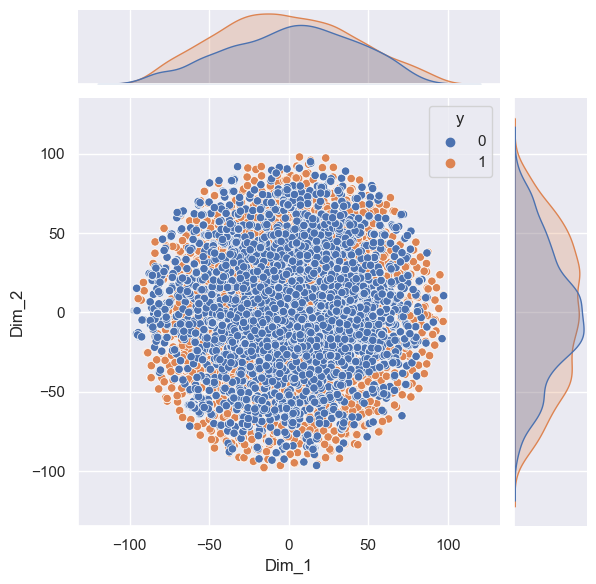

In [15]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')
model = TSNE(n_components=2, perplexity=4, random_state=0)
tsne_data = model.fit_transform(X_array.reshape(X_array.shape[0], number_of_bands * temporal_samples))
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))
tsne_data = pd.concat([tsne_df, pd.DataFrame(labels, columns=['y'])], axis=1)
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "y"))

sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
plt.show()
warnings.filterwarnings('default')

## Sample visualization

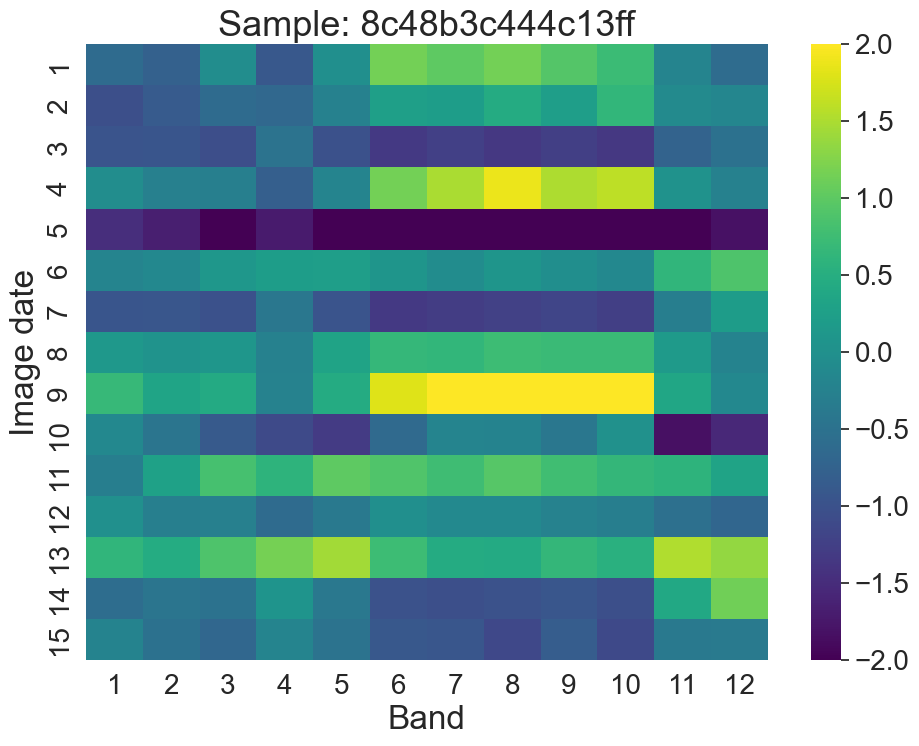

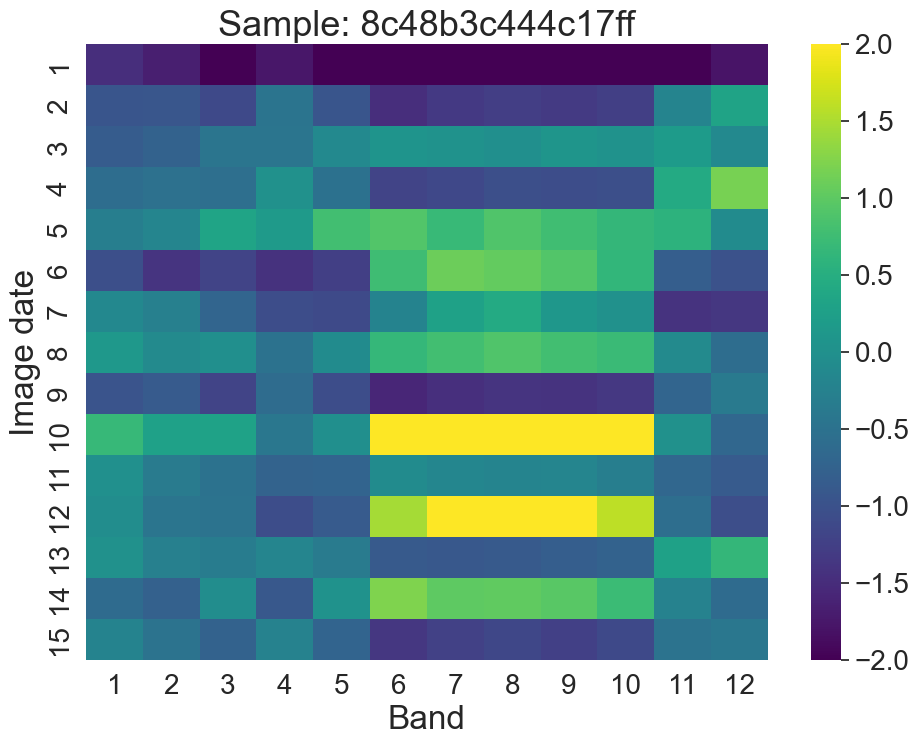

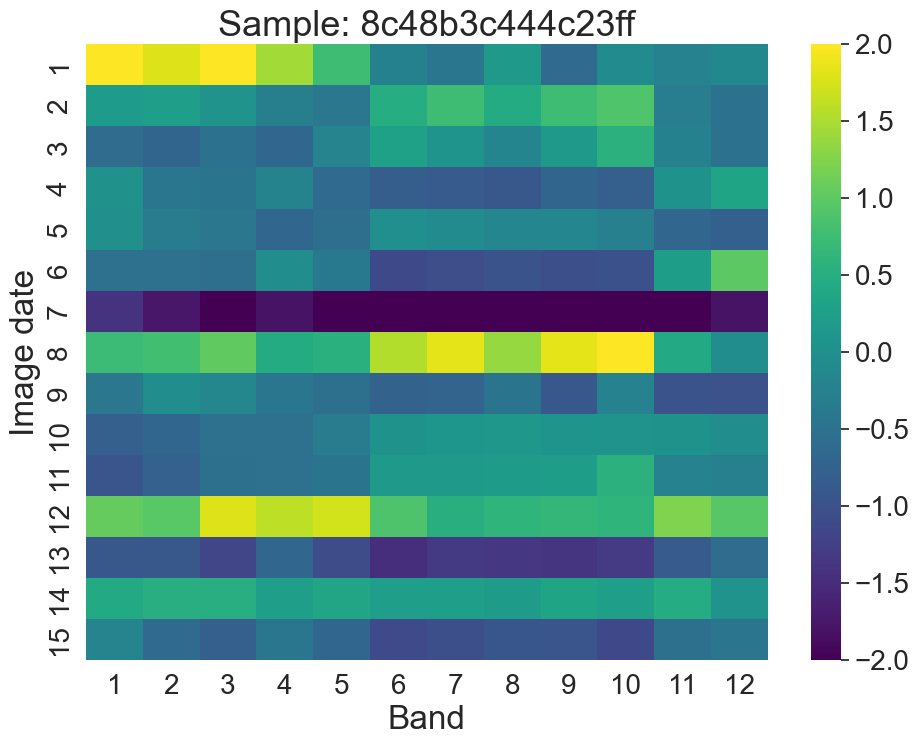

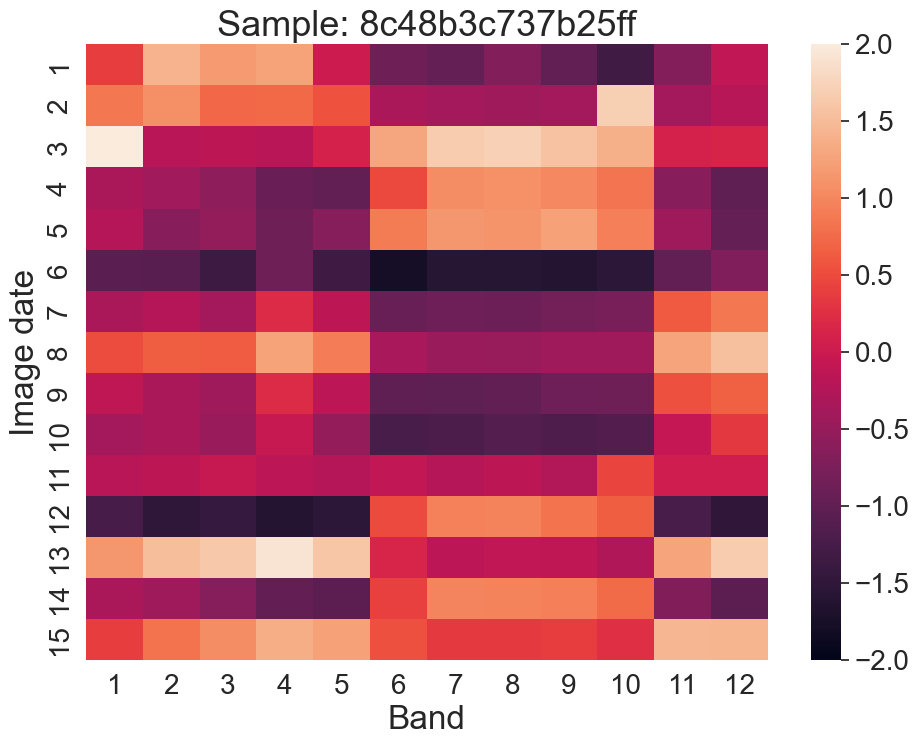

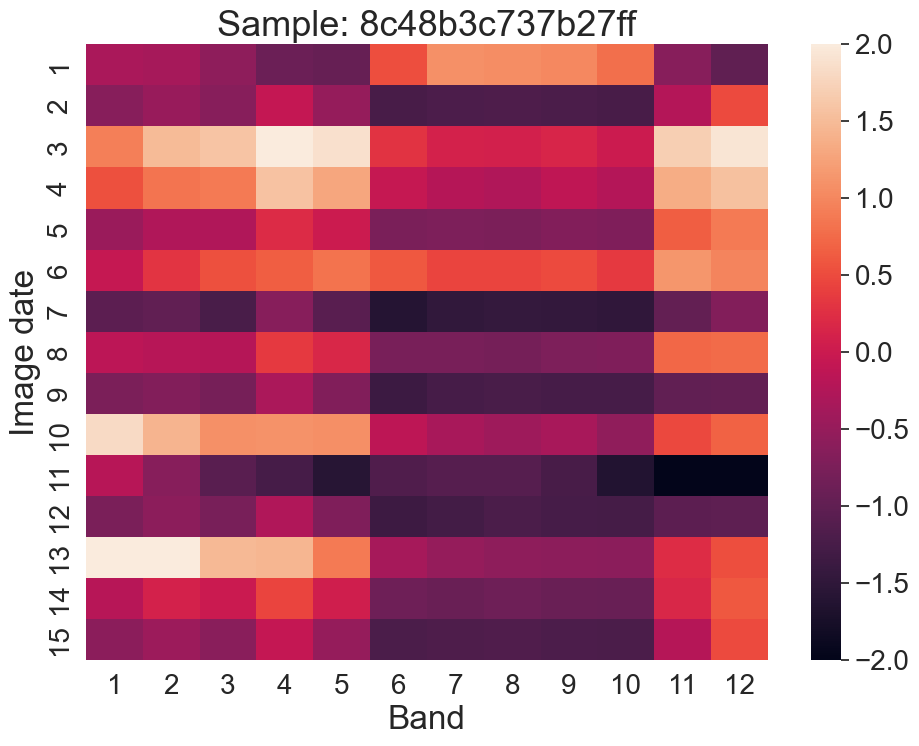

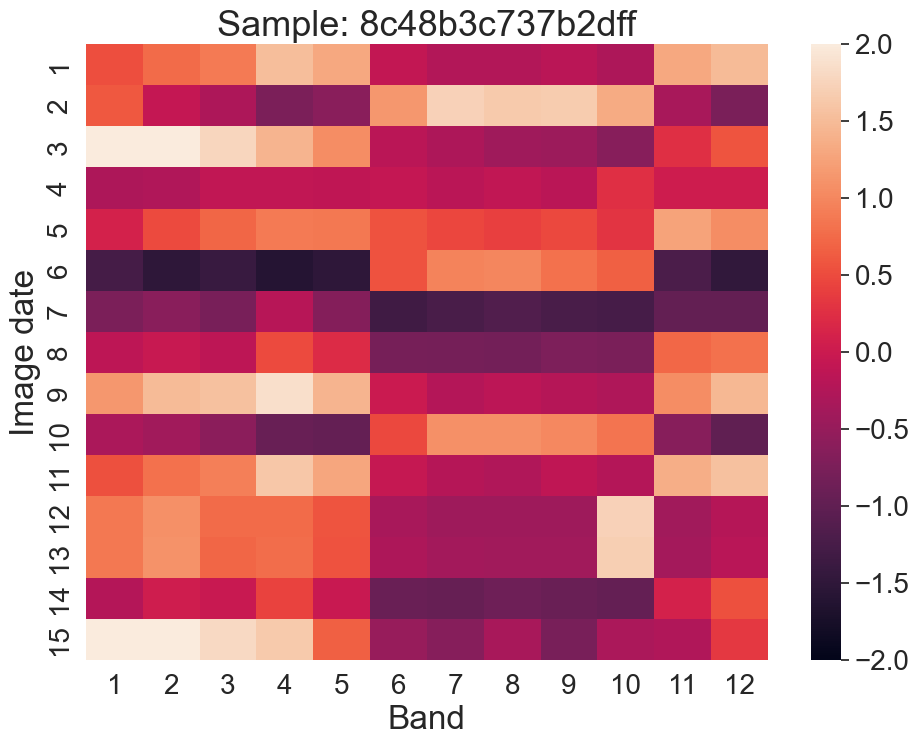

In [16]:
sns.set(rc={'figure.figsize':(11,8)})

for i in range(0,3):
    # This is what a positive sample looks like
    ax = sns.heatmap(X_array[i], annot=False, cmap="viridis", vmin=-2, vmax=2, 
                     xticklabels=range(1,13), yticklabels=range(1,16), 
                     fmt='g', annot_kws={"fontsize":24}, cbar=True)
    ax.set_xlabel("Band",fontsize=24)
    ax.set_ylabel("Image date",fontsize=24)
    ax.set_title('Sample: ' + hexes[i], fontsize=26)
    ax.tick_params(labelsize=20)
    
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=20)
    plt.show()
    


for i in range(-4,-1):  
    ax = sns.heatmap(X_array[i], annot=False, cmap="rocket", vmin=-2, vmax=2, 
                     xticklabels=range(1,13), yticklabels=range(1,16), 
                     fmt='g', annot_kws={"fontsize":20}, cbar=True)
    ax.set_xlabel("Band",fontsize=24)
    ax.set_ylabel("Image date",fontsize=24)
    ax.set_title('Sample: ' + hexes[i], fontsize=26)
    ax.tick_params(labelsize=20)
    
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=20)
    plt.show()

<AxesSubplot:xlabel='variable', ylabel='value'>

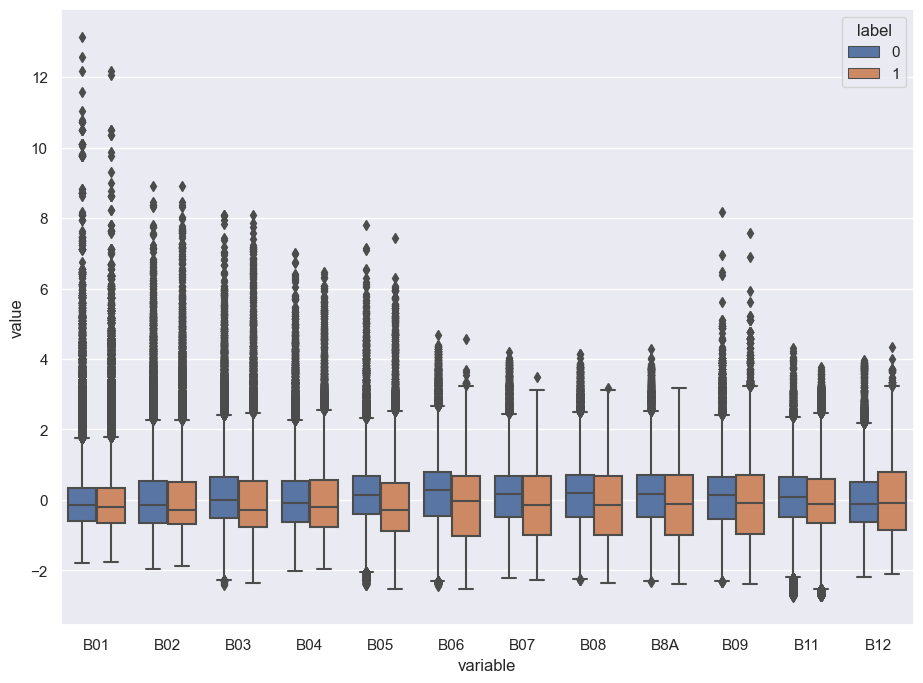

In [17]:
import pandas as pd
import seaborn as sns

value_vars = [i for i in df.columns if (i.startswith('B') or i.startswith('m'))]
id_vars = ['label']
data = pd.melt(df, id_vars=id_vars, value_vars=value_vars)

sns.set(rc={'figure.figsize':(11,8)})
sns.boxplot(x="variable", y="value", hue='label', data=data)

# Check correlation among bands

<AxesSubplot:>

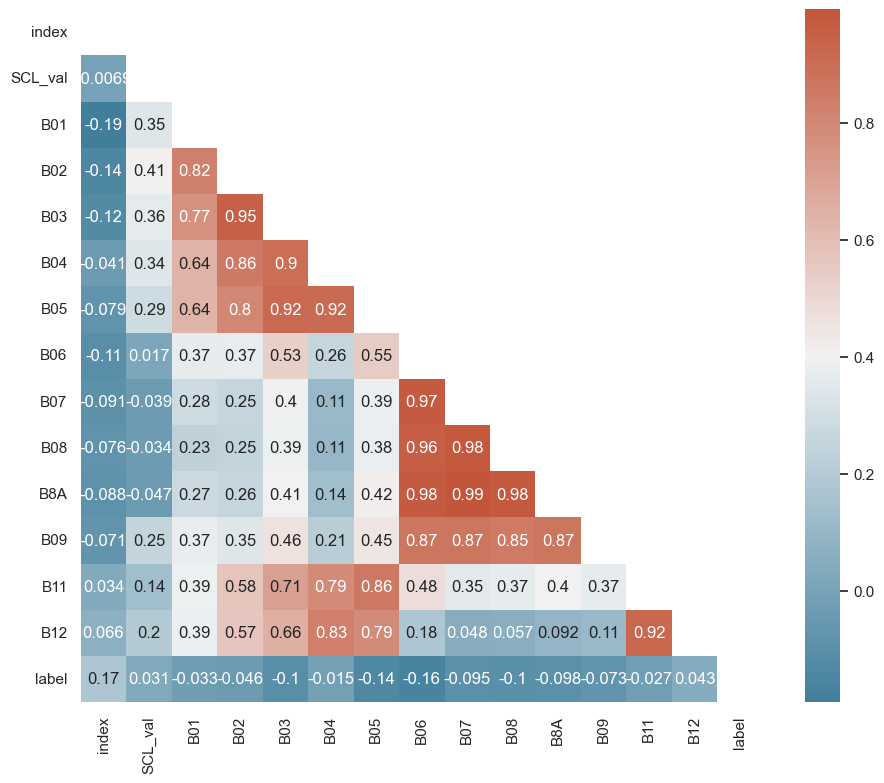

In [18]:
sns.set_theme(style="white")
# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr,mask=mask,cmap=cmap, annot=True )

Avg Positive Similarity:  0.12070687852902152
Avg Negative Similarity:  0.08916280308941527
Avg Disimilarity P-N:  -0.04051426301939706
Avg Disimilarity N-P:  -0.04051426301939706


<AxesSubplot:>

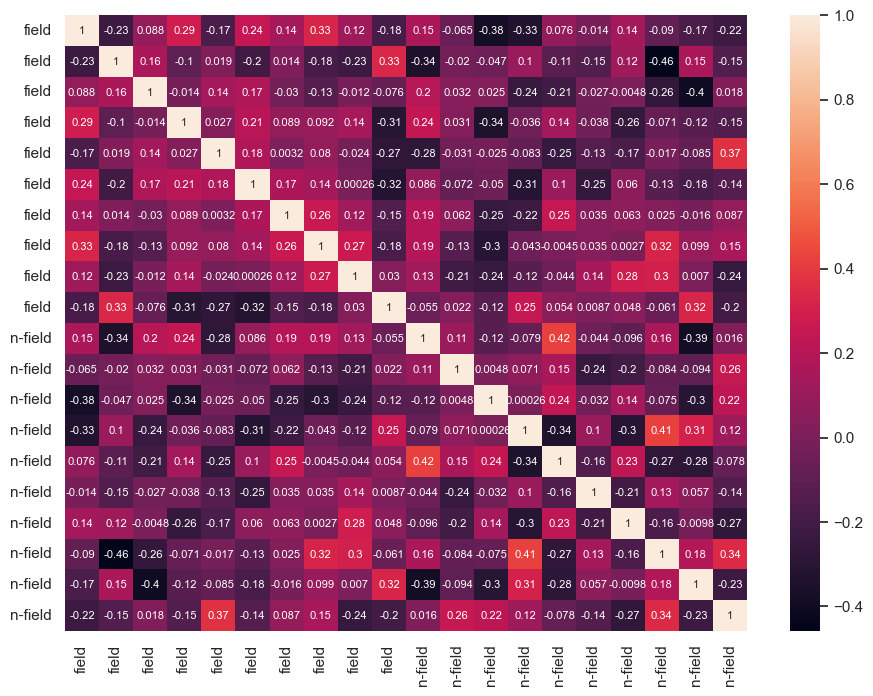

In [19]:
from sklearn import preprocessing
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import normalize

number_of_hexes = 10

X_array_positive = X_array[np.array(labels)==1][:number_of_hexes]
X_array_negative = X_array[np.array(labels)==0][:number_of_hexes]
X_array_samples = np.concatenate([X_array_positive, X_array_negative])
df_labels = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))

vectors = X_array_samples.reshape(number_of_hexes * 2, number_of_bands * temporal_samples)
similarities = cosine_similarity(vectors, vectors)

print('Avg Positive Similarity: ', np.average(similarities[0:number_of_hexes, 0:number_of_hexes]))
print('Avg Negative Similarity: ', np.average(similarities[number_of_hexes:number_of_hexes*2, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity P-N: ', np.average(similarities[0:number_of_hexes, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity N-P: ', np.average(similarities[number_of_hexes:number_of_hexes*2, 0:number_of_hexes]))


sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels,  annot=True, annot_kws={"fontsize":8} )


<a id='model_training'></a>

# 2. Contrastive Learning Model Training

<div>
<img border="5px" src="../res/modeltraining.png" width="1000"/>
</div>

## 2.1 Prepare the Dataset

In [20]:
display(df)

,index,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,...,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp,label
0,0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,-0.619183,-0.777173,...,-0.016920,1.145114,1.004640,1.148058,0.934254,0.724943,-0.189632,-0.596367,2018-10-29 17:04:21,1
1,173,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2B_MSIL2A_20181223T170719_N0211_R069_T14RPQ_2...,8c48b3c444c13ff,2,14RPQ,-1.471766,-1.665015,...,-2.282716,-2.371784,-2.156250,-2.231534,-2.234949,-2.253962,-2.531319,-1.819222,2018-12-23 17:07:19,1
2,173,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2B_MSIL2A_20190611T165859_N0212_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,0.134048,0.058297,...,0.318754,0.668987,0.635081,0.741010,0.715303,0.705536,0.163409,-0.205386,2019-06-11 16:58:59,1
3,173,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2B_MSIL2A_20181213T170709_N0211_R069_T14RPQ_2...,8c48b3c444c13ff,5,14RPQ,-0.968072,-0.944267,...,-1.000224,-1.332125,-1.247528,-1.358115,-1.255252,-1.348323,-0.741537,-0.503672,2018-12-13 17:07:09,1
4,173,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20190427T165901_N0211_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,-1.039698,-0.874436,...,-0.265026,0.245764,0.215534,0.452609,0.230177,0.625484,-0.101372,-0.167357,2019-04-27 16:59:01,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125135,804,2018-10-20T00:00:00+00:00,2019-08-14T00:00:00+00:00,19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17,S2B_MSIL2A_20190522T165859_N0212_R069_T14RPQ_2...,8c48b3c737b65ff,4,14RPQ,-0.309573,-0.398094,...,-0.965562,0.472326,1.044810,1.023936,1.003803,0.841382,-0.635401,-1.014681,2019-05-22 16:58:59,0
125136,802,2018-10-20T00:00:00+00:00,2019-08-14T00:00:00+00:00,19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17,S2A_MSIL2A_20190407T165851_N0211_R069_T14RPQ_2...,8c48b3c737b65ff,3,14RPQ,-0.198668,-0.642500,...,-1.618666,-1.202168,-1.104703,-1.233993,-1.283587,-1.639421,-2.393901,-2.042640,2019-04-07 16:58:51,0
125137,805,2018-10-20T00:00:00+00:00,2019-08-14T00:00:00+00:00,19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17,S2A_MSIL2A_20190427T165901_N0211_R069_T14RPQ_2...,8c48b3c737b65ff,4,14RPQ,-1.263819,-1.522861,...,-1.518329,0.495328,0.933228,0.932670,0.774549,0.648125,-1.197362,-1.468647,2019-04-27 16:59:01,0
125138,724,2018-10-20T00:00:00+00:00,2019-08-14T00:00:00+00:00,19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17,S2B_MSIL2A_20190502T165859_N0211_R069_T14RPQ_2...,8c48b3c737b65ff,5,14RPQ,2.562407,0.357570,...,1.838406,1.842053,1.809815,1.633595,1.709596,1.383957,1.102989,1.860039,2019-05-02 16:58:59,0


In [21]:
if False:
    print('Total of samples:', X_array.shape)

    labels_and_hexes = np.vstack((hexes, labels)).T

    # 80% for training, 10% test and 10% validation
    X_train, X_test, yl_train, yl_test = train_test_split(X_array, labels_and_hexes, test_size=0.2, random_state=42)
    X_val, X_test, yl_val, yl_test = train_test_split(X_test, yl_test, test_size=0.5, random_state=42)

    labeled_train_samples = X_train.shape[0]

    hexes_train, y_train = np.hsplit(yl_train, 2)
    hexes_test, y_test = np.hsplit(yl_test, 2)
    hexes_val, y_val = np.hsplit(yl_val, 2)

    y_val = np.array(y_val).T[0]
    y_test = np.array(y_test).T[0]
    y_train = np.array(y_train).T[0]
    hexes_val = np.array(hexes_val).T[0]
    hexes_test = np.array(hexes_test).T[0]
    hexes_train = np.array(hexes_train).T[0]

    y_train = y_train.astype(np.int)
    y_test = y_test.astype(np.int)
    y_val = y_val.astype(np.int)

    print('Total of training samples:',X_train.shape, len(y_train))
    print('Total of test samples:', X_test.shape, len(y_test))
    print('Total of validation samples:', X_val.shape, len(y_val))


In [22]:
print(sum(np.array(fop) == 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17') + sum(np.array(fop) == '1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24'))

labels_and_hexes = np.vstack((hexes, labels)).T

test_index = np.array(fop) == 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17'
val_index = np.array(fop) == '1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24'

X_train = X_array[~(test_index + val_index)]
yl_train = labels_and_hexes[~(test_index + val_index)]

labeled_train_samples = X_train.shape[0]

X_test = X_array[test_index]
yl_test = labels_and_hexes[test_index]

X_val = X_array[val_index]
yl_val = labels_and_hexes[val_index]

hexes_train, y_train = np.hsplit(yl_train, 2)
hexes_test, y_test = np.hsplit(yl_test, 2)
hexes_val, y_val = np.hsplit(yl_val, 2)

y_val = np.array(y_val).T[0]
y_test = np.array(y_test).T[0]
y_train = np.array(y_train).T[0]
hexes_val = np.array(hexes_val).T[0]
hexes_test = np.array(hexes_test).T[0]
hexes_train = np.array(hexes_train).T[0]

y_train = y_train.astype(np.int)
y_test = y_test.astype(np.int)
y_val = y_val.astype(np.int)

print(X_train.shape, X_test.shape, X_val.shape)

1519
(6823, 15, 12) (638, 15, 12) (881, 15, 12)


In [23]:
df_classes = pd.DataFrame(y_test, columns=['label'])
df_hexes = pd.DataFrame(hexes_test, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    #print(row)
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 1:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'black', 'weight': 0.5})
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
       
    #folium.Popup(str(similarities[0][index])).add_to(geo_j)
    folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

In [24]:
# Clean test and validation datasets
if False:
    # Treat hexes in non conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')
    
    drop_index = np.isin(hexes_val,drop_list)
    drop_index = [i for i, x in enumerate(drop_index) if x]
    X_val = np.delete(X_val, drop_index, axis=0)
    y_val = np.delete(y_val, drop_index, axis=0)
    hexes_val = np.delete(hexes_val, drop_index, axis=0)
    
    drop_index = np.isin(hexes_test,drop_list)
    drop_index = [i for i, x in enumerate(drop_index) if x]
    hexes_test = np.delete(hexes_test, drop_index, axis=0)
    X_test = np.delete(X_test, drop_index, axis=0)     
    y_test = np.delete(y_test, drop_index, axis=0)

    # Treat false negatives
    fn_list = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')
    
    fn_index = np.isin(hexes_val, fn_list)
    y_val[fn_index] = 1
    
    fn_index = np.isin(hexes_test, fn_list)
    y_test[fn_index] = 1
    
print(sum(np.array(y_train)==0),sum(np.array(y_train)==1))
print(sum(np.array(y_test)==0),sum(np.array(y_test)==1))
print(sum(np.array(y_val)==0),sum(np.array(y_val)==1))


3020 3803
269 369
298 583


In [25]:
def prepare_dataset():
    labeled_batch_size = labeled_train_samples // steps_per_epoch
    batch_size = labeled_batch_size
 
    train_dataset = tf.data.Dataset\
        .from_tensor_slices((X_train, y_train))\
        .shuffle(buffer_size=10 * labeled_batch_size)\
        .batch(labeled_batch_size)
    
    test_dataset = tf.data.Dataset\
        .from_tensor_slices((X_test, y_test))\
        .batch(batch_size)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    
    validation_dataset = tf.data.Dataset\
        .from_tensor_slices((X_val, y_val))\
        .batch(5)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    
    full_dataset = tf.data.Dataset\
        .from_tensor_slices((X_array, labels))\
        .batch(5)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)

    return batch_size, train_dataset, test_dataset, validation_dataset, full_dataset

    
    
batch_size, train_dataset, test_dataset, validation_dataset, full_dataset = prepare_dataset()

In [26]:
# Distorts the color distibutions of images
class RandomAugmentSatelliteBands(layers.Layer):
    def __init__(self, jitter=0, **kwargs):
        super().__init__(**kwargs)

        self.jitter = jitter

    def get_config(self):
        config = super().get_config()
        config.update({"jitter": self.jitter})
        return config

    def call(self, images, training=True):
        if training:
            batch_size = tf.shape(images)[0]
            
            
            # jitter colors
            jitter_matrices = tf.random.uniform(
                (batch_size, temporal_samples, 1), minval=1 - self.jitter, maxval=1 + self.jitter
            )
            
            jitter_matrices = tf.concat([jitter_matrices,jitter_matrices,jitter_matrices,jitter_matrices,
                                         jitter_matrices,jitter_matrices,jitter_matrices,jitter_matrices,
                                         jitter_matrices,jitter_matrices,jitter_matrices,jitter_matrices], axis=2)
            
            
            
            images = tf.round(images * jitter_matrices)
            
            # shuffle dates
            #images = tf.random.shuffle(tf.transpose(images, [1, 0, 2]))
            #images = tf.transpose(images, [1, 0, 2])
            
            
        return images

# Define the encoder architecture
def get_encoder():
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Flatten(),
            layers.Dense(width, activation="relu"),
        ],
        name="encoder",
    )

# Image augmentation module
def get_augmenter(jitter):
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            RandomAugmentSatelliteBands(jitter),
        ]
    )


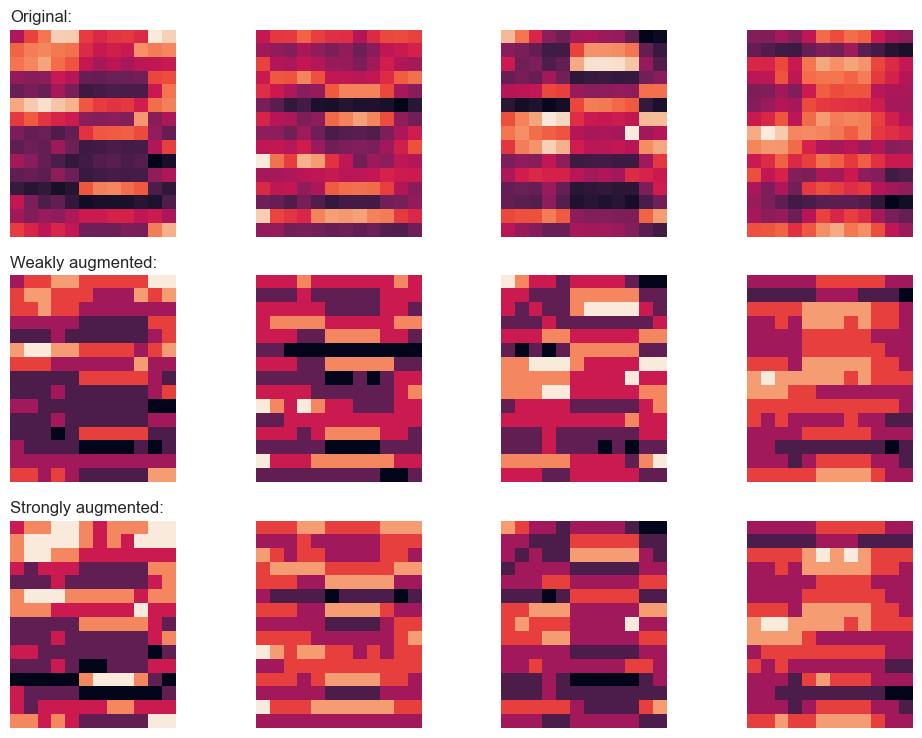

In [27]:
def visualize_augmentations(num_images):
    # Sample a batch from a dataset
    images = next(iter(train_dataset))[0][:num_images]

    # Apply augmentations
    augmented_images = zip(
        images,
        get_augmenter(**classification_augmentation)(images),
        get_augmenter(**contrastive_augmentation)(images),
    )
    row_titles = [
        "Original:",
        "Weakly augmented:",
        "Strongly augmented:",
    ]
    plt.figure(figsize=(num_images * 2.5, 4 * 2.5), dpi=100)
    for column, image_row in enumerate(augmented_images):
        for row, image in enumerate(image_row):
            plt.subplot(4, num_images, row * num_images + column + 1)
            plt.imshow(image)
            if column == 0:
                plt.title(row_titles[row], loc="left")
            plt.axis("off")
    plt.tight_layout()


visualize_augmentations(num_images=4)

In [28]:
# Baseline supervised training with random initialization
baseline_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        get_encoder(),
        layers.Dense(1, activation='sigmoid'),
    ],
    name="baseline_model",
)
baseline_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

baseline_history = baseline_model.fit(
    train_dataset, epochs=num_epochs, validation_data=test_dataset
)

print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

Epoch 1/500
11/11 [==============================] - 1s 22ms/step - loss: 0.6864 - acc: 0.5440 - val_loss: 0.6637 - val_acc: 0.6379
Epoch 2/500
11/11 [==============================] - 0s 12ms/step - loss: 0.6553 - acc: 0.6658 - val_loss: 0.6433 - val_acc: 0.6223
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 0.5914 - acc: 0.7268 - val_loss: 0.6324 - val_acc: 0.6473
Epoch 4/500
11/11 [==============================] - 0s 9ms/step - loss: 0.5127 - acc: 0.7560 - val_loss: 0.4499 - val_acc: 0.8323
Epoch 5/500
11/11 [==============================] - 0s 9ms/step - loss: 0.4656 - acc: 0.7888 - val_loss: 0.3971 - val_acc: 0.8448
Epoch 6/500
11/11 [==============================] - 0s 10ms/step - loss: 0.4554 - acc: 0.7942 - val_loss: 0.6423 - val_acc: 0.7132
Epoch 7/500
11/11 [==============================] - 0s 9ms/step - loss: 0.4231 - acc: 0.8139 - val_loss: 0.4125 - val_acc: 0.8292
Epoch 8/500
11/11 [==============================] - 0s 10ms/step - loss: 0.402

Epoch 63/500
11/11 [==============================] - 0s 9ms/step - loss: 0.3243 - acc: 0.8693 - val_loss: 0.3930 - val_acc: 0.8323
Epoch 64/500
11/11 [==============================] - 0s 9ms/step - loss: 0.3156 - acc: 0.8679 - val_loss: 0.3751 - val_acc: 0.8401
Epoch 65/500
11/11 [==============================] - 0s 9ms/step - loss: 0.3313 - acc: 0.8638 - val_loss: 0.3283 - val_acc: 0.8574
Epoch 66/500
11/11 [==============================] - 0s 10ms/step - loss: 0.3273 - acc: 0.8675 - val_loss: 0.3885 - val_acc: 0.8292
Epoch 67/500
11/11 [==============================] - 0s 10ms/step - loss: 0.3183 - acc: 0.8691 - val_loss: 0.3154 - val_acc: 0.8683
Epoch 68/500
11/11 [==============================] - 0s 9ms/step - loss: 0.3245 - acc: 0.8706 - val_loss: 0.4070 - val_acc: 0.8354
Epoch 69/500
11/11 [==============================] - 0s 9ms/step - loss: 0.3313 - acc: 0.8619 - val_loss: 0.4464 - val_acc: 0.8197
Epoch 70/500
11/11 [==============================] - 0s 8ms/step - loss: 

11/11 [==============================] - 0s 9ms/step - loss: 0.3737 - acc: 0.8445 - val_loss: 0.6737 - val_acc: 0.7273
Epoch 186/500
11/11 [==============================] - 0s 11ms/step - loss: 0.4097 - acc: 0.8134 - val_loss: 0.5542 - val_acc: 0.7351
Epoch 187/500
11/11 [==============================] - 0s 11ms/step - loss: 0.3489 - acc: 0.8461 - val_loss: 0.4825 - val_acc: 0.8103
Epoch 188/500
11/11 [==============================] - 0s 9ms/step - loss: 0.2786 - acc: 0.8860 - val_loss: 0.4836 - val_acc: 0.8166
Epoch 189/500
11/11 [==============================] - 0s 10ms/step - loss: 0.2580 - acc: 0.8999 - val_loss: 0.3971 - val_acc: 0.8464
Epoch 190/500
11/11 [==============================] - 0s 10ms/step - loss: 0.2371 - acc: 0.9084 - val_loss: 0.4263 - val_acc: 0.8339
Epoch 191/500
11/11 [==============================] - 0s 9ms/step - loss: 0.2311 - acc: 0.9102 - val_loss: 0.3927 - val_acc: 0.8480
Epoch 192/500
11/11 [==============================] - 0s 10ms/step - loss: 0.2

11/11 [==============================] - 0s 10ms/step - loss: 0.1334 - acc: 0.9499 - val_loss: 0.4836 - val_acc: 0.8433
Epoch 308/500
11/11 [==============================] - 0s 10ms/step - loss: 0.1345 - acc: 0.9475 - val_loss: 0.4979 - val_acc: 0.8448
Epoch 309/500
11/11 [==============================] - 0s 11ms/step - loss: 0.1421 - acc: 0.9439 - val_loss: 0.5058 - val_acc: 0.8323
Epoch 310/500
11/11 [==============================] - 0s 10ms/step - loss: 0.2153 - acc: 0.9126 - val_loss: 0.7285 - val_acc: 0.7947
Epoch 311/500
11/11 [==============================] - 0s 9ms/step - loss: 0.2555 - acc: 0.8965 - val_loss: 0.4674 - val_acc: 0.8574
Epoch 312/500
11/11 [==============================] - 0s 9ms/step - loss: 0.1971 - acc: 0.9220 - val_loss: 0.5188 - val_acc: 0.8448
Epoch 313/500
11/11 [==============================] - 0s 9ms/step - loss: 0.1626 - acc: 0.9357 - val_loss: 0.4823 - val_acc: 0.8370
Epoch 314/500
11/11 [==============================] - 0s 9ms/step - loss: 0.16

11/11 [==============================] - 0s 10ms/step - loss: 0.0806 - acc: 0.9695 - val_loss: 0.6561 - val_acc: 0.8119
Epoch 430/500
11/11 [==============================] - 0s 10ms/step - loss: 0.0785 - acc: 0.9716 - val_loss: 0.6577 - val_acc: 0.8292
Epoch 431/500
11/11 [==============================] - 0s 10ms/step - loss: 0.0691 - acc: 0.9748 - val_loss: 0.6505 - val_acc: 0.8339
Epoch 432/500
11/11 [==============================] - 0s 10ms/step - loss: 0.0696 - acc: 0.9749 - val_loss: 0.6203 - val_acc: 0.8401
Epoch 433/500
11/11 [==============================] - 0s 10ms/step - loss: 0.1204 - acc: 0.9535 - val_loss: 0.8889 - val_acc: 0.7837
Epoch 434/500
11/11 [==============================] - 0s 9ms/step - loss: 0.1374 - acc: 0.9446 - val_loss: 0.6241 - val_acc: 0.8245
Epoch 435/500
11/11 [==============================] - 0s 8ms/step - loss: 0.0956 - acc: 0.9647 - val_loss: 0.6965 - val_acc: 0.8166
Epoch 436/500
11/11 [==============================] - 0s 8ms/step - loss: 0.0

In [29]:
# Define the contrastive model with model-subclassing

class ContrastiveModel(keras.Model):
    def __init__(self):
        super().__init__()

        self.temperature = temperature
        self.contrastive_augmenter = get_augmenter(**contrastive_augmentation)
        self.classification_augmenter = get_augmenter(**classification_augmentation)
        self.encoder = get_encoder()

        
        # Non-linear MLP as projection head
        self.projection_head = keras.Sequential(
            [
                keras.Input(shape=(width,)),
                layers.Dense(width, activation="relu"),
                layers.Dense(width),
            ],
            name="projection_head",
        )
        # Single dense layer for linear probing
        self.linear_probe = keras.Sequential(
            [layers.Input(shape=(width,)), layers.Dense(1, activation='sigmoid')], name="linear_probe"
        )

        self.encoder.summary()
        self.projection_head.summary()
        self.linear_probe.summary()

    def compile(self, contrastive_optimizer, probe_optimizer, **kwargs):
        super().compile(**kwargs)

        self.contrastive_optimizer = contrastive_optimizer
        self.probe_optimizer = probe_optimizer

        # self.contrastive_loss will be defined as a method
        self.probe_loss = keras.losses.BinaryCrossentropy(from_logits=False)
        self.contrastive_loss_tracker = keras.metrics.Mean(name="c_loss")
        self.contrastive_accuracy = keras.metrics.BinaryAccuracy(name="c_acc")
        self.probe_loss_tracker = keras.metrics.Mean(name="p_loss")
        self.probe_accuracy = keras.metrics.BinaryAccuracy(name="p_acc")

    @property
    def metrics(self):
        return [
            self.contrastive_loss_tracker,
            self.contrastive_accuracy,
            self.probe_loss_tracker,
            self.probe_accuracy,
        ]

    def contrastive_loss(self, projections_1, projections_2):
        # InfoNCE loss (information noise-contrastive estimation)
        # NT-Xent loss (normalized temperature-scaled cross entropy)

        # Cosine similarity: the dot product of the l2-normalized feature vectors
        projections_1 = tf.math.l2_normalize(projections_1, axis=1)
        projections_2 = tf.math.l2_normalize(projections_2, axis=1)
        
        
        similarities = (
            tf.matmul(projections_1, projections_2, transpose_b=True) / self.temperature
        )        

        # The similarity between the representations of two augmented views of the
        # same hex should be higher than their similarity with other views
        batch_size = tf.shape(projections_1)[0]
    
        contrastive_labels = tf.range(batch_size)
        self.contrastive_accuracy.update_state(contrastive_labels, similarities)
        self.contrastive_accuracy.update_state(contrastive_labels, tf.transpose(similarities))

        # The temperature-scaled similarities are used as logits for cross-entropy
        # a symmetrized version of the loss is used here
        loss_1_2 = keras.losses.binary_crossentropy(
            contrastive_labels, similarities, from_logits=False
        )
        
        loss_2_1 = keras.losses.binary_crossentropy(
            contrastive_labels, tf.transpose(similarities), from_logits=False
        )
        
        
        return (loss_1_2 + loss_2_1) / 2

    def train_step(self, data):
        (labeled_images, labels) = data

        # Both labeled and unlabeled images are used, without labels
        images = labeled_images
        
        # Each image is augmented twice, differently
        augmented_images_1 = self.contrastive_augmenter(images, training=True)
        augmented_images_2 = self.contrastive_augmenter(images, training=True)
        
        with tf.GradientTape() as tape:
            features_1 = self.encoder(augmented_images_1, training=True)
            features_2 = self.encoder(augmented_images_2, training=True)
            # The representations are passed through a projection mlp
            projections_1 = self.projection_head(features_1, training=True)
            projections_2 = self.projection_head(features_2, training=True)
            contrastive_loss = self.contrastive_loss(projections_1, projections_2)
        gradients = tape.gradient(
            contrastive_loss,
            self.encoder.trainable_weights + self.projection_head.trainable_weights,
        )
        self.contrastive_optimizer.apply_gradients(
            zip(
                gradients,
                self.encoder.trainable_weights + self.projection_head.trainable_weights,
            )
        )
        self.contrastive_loss_tracker.update_state(contrastive_loss)

        # Labels are only used in evalutation for an on-the-fly logistic regression
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=True
        )
        with tf.GradientTape() as tape:
            # the encoder is used in inference mode here to avoid regularization
            # and updating the batch normalization paramers if they are used
            features = self.encoder(preprocessed_images, training=False)
            class_logits = self.linear_probe(features, training=True)
            probe_loss = self.probe_loss(labels, class_logits)
        gradients = tape.gradient(probe_loss, self.linear_probe.trainable_weights)
        self.probe_optimizer.apply_gradients(
            zip(gradients, self.linear_probe.trainable_weights)
        )
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, data):
        labeled_images, labels = data

        # For testing the components are used with a training=False flag
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=False
        )
        features = self.encoder(preprocessed_images, training=False)
        class_logits = self.linear_probe(features, training=False)
        probe_loss = self.probe_loss(labels, class_logits)
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        # Only the probe metrics are logged at test time
        return {m.name: m.result() for m in self.metrics[2:]}


# Contrastive pretraining
pretraining_model = ContrastiveModel()

pretraining_model.compile(
    contrastive_optimizer=keras.optimizers.Adam(),
    probe_optimizer=keras.optimizers.Adam(),
    run_eagerly=True
)

pretraining_history = pretraining_model.fit(
    train_dataset, epochs=num_epochs, validation_data=train_dataset
)


print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_4 (Conv1D)            (None, 13, 30)            1110      
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 11, 30)            2730      
_________________________________________________________________
conv1d_6 (Conv1D)            (None, 9, 30)             2730      
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 7, 30)             2730      
_________________________________________________________________
flatten_1 (Flatten)          (None, 210)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 30)                6330      
Total params: 15,630
Trainable params: 15,630
Non-trainable params: 0
_______________________________________________________

Epoch 80/500
11/11 [==============================] - 1s 113ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6744 - p_acc: 0.5718 - val_p_loss: 0.6706 - val_p_acc: 0.5743
Epoch 81/500
11/11 [==============================] - 1s 117ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6810 - p_acc: 0.5399 - val_p_loss: 0.6698 - val_p_acc: 0.5741
Epoch 82/500
11/11 [==============================] - 1s 117ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6746 - p_acc: 0.5713 - val_p_loss: 0.6886 - val_p_acc: 0.5137
Epoch 83/500
11/11 [==============================] - 1s 119ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6851 - p_acc: 0.5424 - val_p_loss: 0.6594 - val_p_acc: 0.6050
Epoch 84/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6727 - p_acc: 0.6018 - val_p_loss: 0.6733 - val_p_acc: 0.5757
Epoch 85/500
11/11 [==============================] - 1s 120ms/step - c_loss: -5203.3423 - c_acc: 0.0016 

11/11 [==============================] - 1s 121ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6721 - p_acc: 0.5631 - val_p_loss: 0.6610 - val_p_acc: 0.6106
Epoch 171/500
11/11 [==============================] - 1s 128ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6783 - p_acc: 0.5949 - val_p_loss: 0.6621 - val_p_acc: 0.5827
Epoch 172/500
11/11 [==============================] - 1s 119ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6673 - p_acc: 0.6011 - val_p_loss: 0.6676 - val_p_acc: 0.5862
Epoch 173/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6650 - p_acc: 0.6021 - val_p_loss: 0.6554 - val_p_acc: 0.6454
Epoch 174/500
11/11 [==============================] - 1s 112ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6631 - p_acc: 0.6312 - val_p_loss: 0.6750 - val_p_acc: 0.5836
Epoch 175/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss

11/11 [==============================] - 1s 114ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6549 - p_acc: 0.6169 - val_p_loss: 0.6466 - val_p_acc: 0.6345
Epoch 261/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6715 - p_acc: 0.5812 - val_p_loss: 0.6580 - val_p_acc: 0.6326
Epoch 262/500
11/11 [==============================] - 1s 117ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6541 - p_acc: 0.6418 - val_p_loss: 0.6623 - val_p_acc: 0.6349
Epoch 263/500
11/11 [==============================] - 1s 118ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6535 - p_acc: 0.6146 - val_p_loss: 0.6435 - val_p_acc: 0.6629
Epoch 264/500
11/11 [==============================] - 1s 115ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6893 - p_acc: 0.5485 - val_p_loss: 0.6527 - val_p_acc: 0.6287
Epoch 265/500
11/11 [==============================] - 1s 110ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss

11/11 [==============================] - 1s 119ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6538 - p_acc: 0.6664 - val_p_loss: 0.6723 - val_p_acc: 0.6351
Epoch 351/500
11/11 [==============================] - 1s 114ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6504 - p_acc: 0.6391 - val_p_loss: 0.6438 - val_p_acc: 0.6655
Epoch 352/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6593 - p_acc: 0.6128 - val_p_loss: 0.6402 - val_p_acc: 0.6958
Epoch 353/500
11/11 [==============================] - 1s 124ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6484 - p_acc: 0.6742 - val_p_loss: 0.6430 - val_p_acc: 0.6970
Epoch 354/500
11/11 [==============================] - 1s 134ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6542 - p_acc: 0.6736 - val_p_loss: 0.6411 - val_p_acc: 0.6662
Epoch 355/500
11/11 [==============================] - 1s 123ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss

11/11 [==============================] - 1s 122ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6526 - p_acc: 0.6474 - val_p_loss: 0.6584 - val_p_acc: 0.6377
Epoch 441/500
11/11 [==============================] - 1s 122ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6330 - p_acc: 0.6758 - val_p_loss: 0.6351 - val_p_acc: 0.6983
Epoch 442/500
11/11 [==============================] - 2s 137ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6344 - p_acc: 0.6696 - val_p_loss: 0.6468 - val_p_acc: 0.6359
Epoch 443/500
11/11 [==============================] - 1s 116ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6519 - p_acc: 0.6386 - val_p_loss: 0.6492 - val_p_acc: 0.6639
Epoch 444/500
11/11 [==============================] - 1s 120ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss: 0.6305 - p_acc: 0.6665 - val_p_loss: 0.6485 - val_p_acc: 0.6648
Epoch 445/500
11/11 [==============================] - 1s 125ms/step - c_loss: -5203.3423 - c_acc: 0.0016 - p_loss

# Encoding a few samples

In [30]:
# Encoder for validation
encoder_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
    ],
    name="encoder_model",
)

encoded_vectors = encoder_model.predict(X_val)

print(encoded_vectors.shape)


(881, 30)


# Visualization of the encoded samples in the XY space

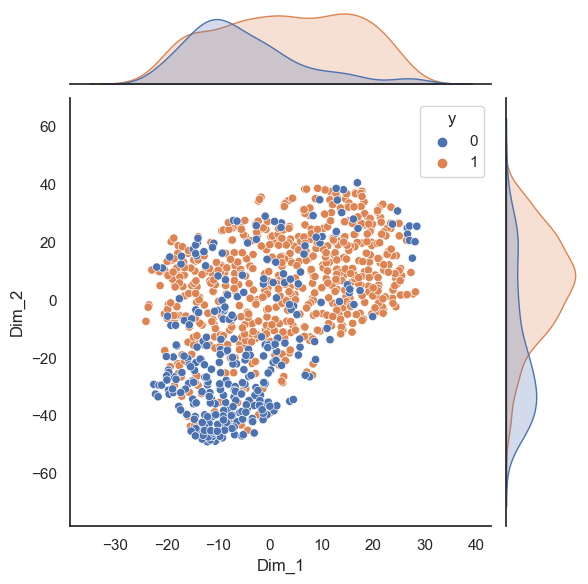

In [31]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings


warnings.filterwarnings('ignore')
model = TSNE(n_components=2, random_state=0)
tsne_data = model.fit_transform(encoded_vectors)
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))

tsne_df = pd.concat([tsne_df, pd.DataFrame(y_val, columns=['y'])], axis=1)

sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
plt.show()
warnings.filterwarnings('default')

# Checking similarities of encoded vectors

### Check similarities between first 15 positive and negative samples from TEST dataset

Avg Positive Similarity:  0.94723344
Avg Negative Similarity:  0.9430016
Avg Disimilarity P-N:  0.9321374
Avg Disimilarity N-P:  0.93213737


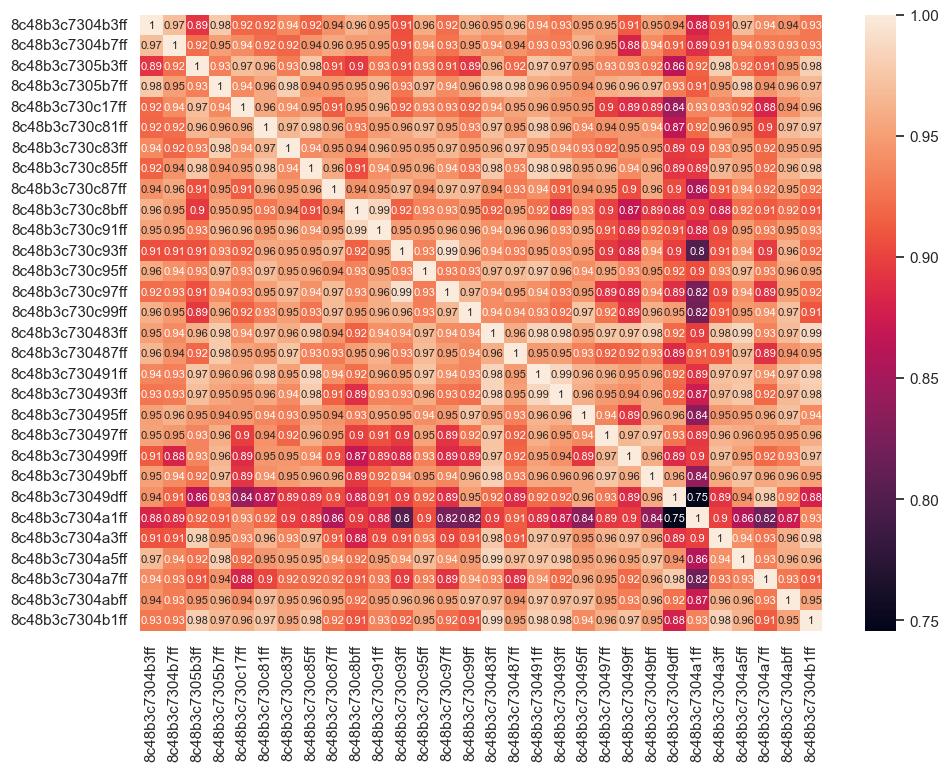

In [32]:
from sklearn.metrics.pairwise import cosine_similarity

number_of_hexes= 15

encoded_vectors = encoder_model.predict(X_test)

df_test = pd.DataFrame(encoded_vectors)
df_test = pd.concat([
                     df_test,
                     pd.DataFrame(y_test, columns=['y'])
                     ], axis=1)

df_sample_positive = df_test.loc[df_test['y'] == 1].head(number_of_hexes).drop('y', axis=1)
df_sample_negative = df_test.loc[df_test['y'] == 0].head(number_of_hexes).drop('y', axis=1)
df_subsample = pd.concat([df_sample_positive, df_sample_negative])
df_classes = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))
df_labels = np.concatenate((hexes_test[df_test['y'] == 1][0:number_of_hexes], hexes_test[df_test['y'] == 0][0:number_of_hexes]))

similarities = cosine_similarity(df_subsample.to_numpy())

print('Avg Positive Similarity: ', np.average(similarities[0:number_of_hexes, 0:number_of_hexes]))
print('Avg Negative Similarity: ', np.average(similarities[number_of_hexes:number_of_hexes*2, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity P-N: ', np.average(similarities[0:number_of_hexes, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity N-P: ', np.average(similarities[number_of_hexes:number_of_hexes*2, 0:number_of_hexes]))

sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

df_classes = pd.DataFrame(df_classes, columns=['label'])
df_hexes = pd.DataFrame(df_labels, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    #print(row)
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 'field':
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'black', 'weight': 0.5})
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
       
    folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

Avg Positive Similarity:  0.94317394
Avg Negative Similarity:  0.9270562
Avg Disimilarity P-N:  0.92361933
Avg Disimilarity N-P:  0.92361933


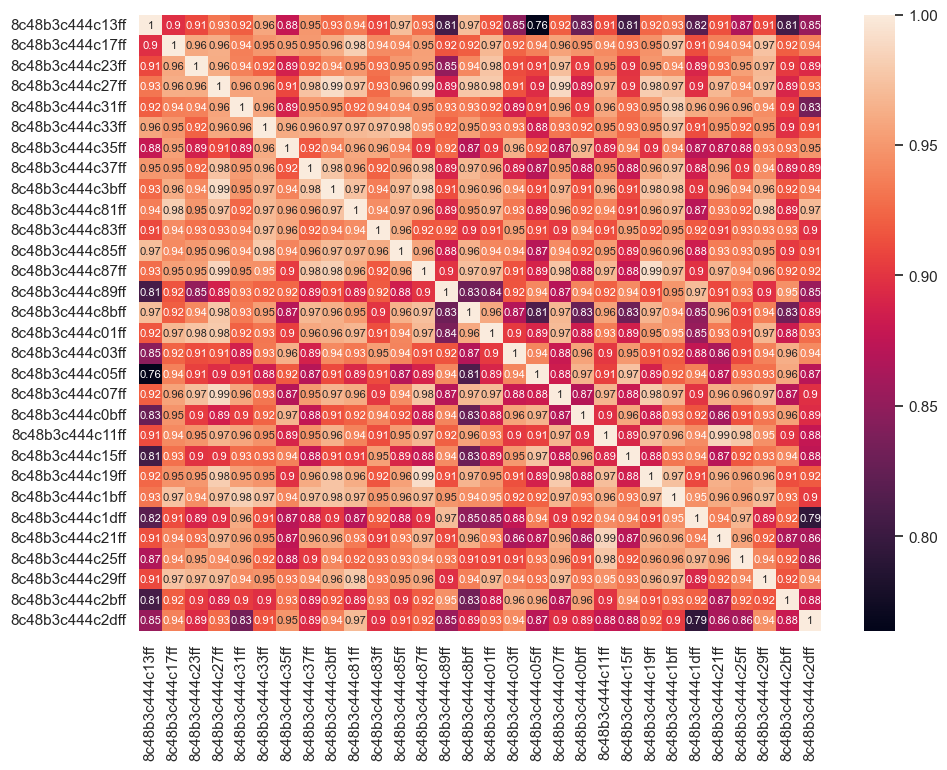

In [33]:
from sklearn.metrics.pairwise import cosine_similarity

number_of_hexes= 15

encoded_vectors = encoder_model.predict(X_val)

df_val = pd.DataFrame(encoded_vectors)
df_val = pd.concat([
                     df_val,
                     pd.DataFrame(y_val, columns=['y'])
                     ], axis=1)

df_sample_positive = df_val.loc[df_val['y'] == 1].head(number_of_hexes).drop('y', axis=1)
df_sample_negative = df_val.loc[df_val['y'] == 0].head(number_of_hexes).drop('y', axis=1)
df_subsample = pd.concat([df_sample_positive, df_sample_negative])
df_classes = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))
df_labels = np.concatenate((hexes_val[df_val['y'] == 1][0:number_of_hexes], hexes_val[df_val['y'] == 0][0:number_of_hexes]))

similarities = cosine_similarity(df_subsample.to_numpy())

print('Avg Positive Similarity: ', np.average(similarities[0:number_of_hexes, 0:number_of_hexes]))
print('Avg Negative Similarity: ', np.average(similarities[number_of_hexes:number_of_hexes*2, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity P-N: ', np.average(similarities[0:number_of_hexes, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity N-P: ', np.average(similarities[number_of_hexes:number_of_hexes*2, 0:number_of_hexes]))

sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

df_classes = pd.DataFrame(df_classes, columns=['label'])
df_hexes = pd.DataFrame(df_labels, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    #print(row)
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 'field':
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'black', 'weight': 0.5})
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
       
    #folium.Popup(str(similarities[0][index])).add_to(geo_j)
    folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

## Softmax heatmap

[0.03688083 0.03328709 0.03370819 0.03447539 0.03403972 0.03537178
 0.03265758 0.03508849 0.03424991 0.03459204 0.03369964 0.03586924
 0.0343198  0.03042999 0.03587336 0.03392836 0.03163673 0.02912373
 0.03405266 0.03106198 0.03375967 0.03037621 0.03420426 0.03445248
 0.0307438  0.03384215 0.03228902 0.03371834 0.03040663 0.03186101] 1.000000074505806


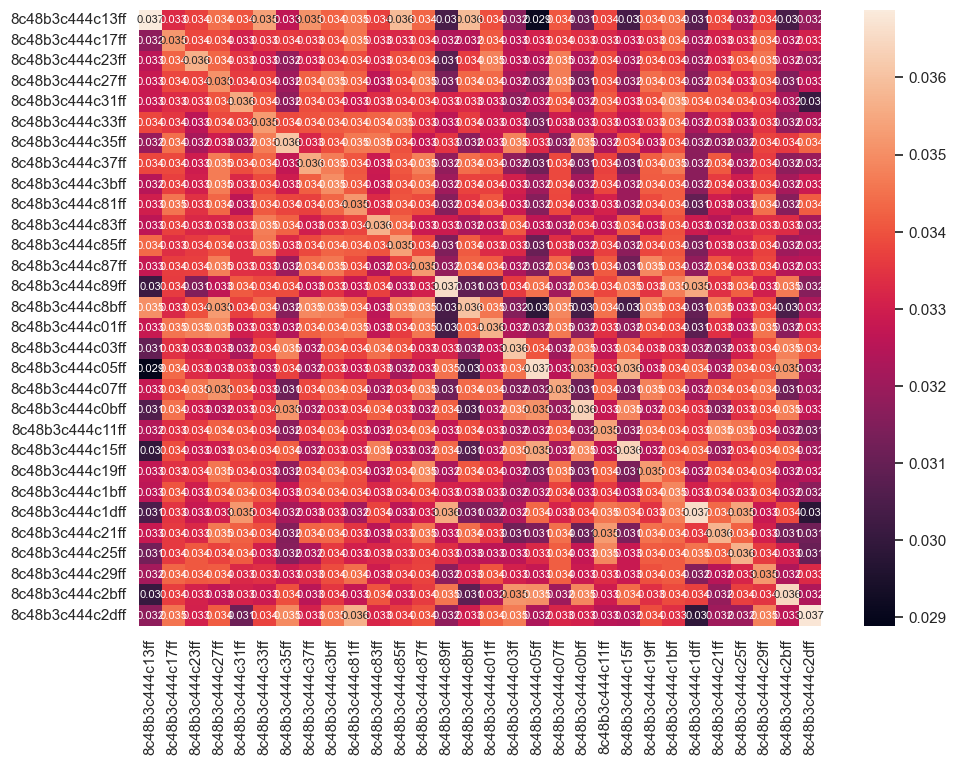

In [34]:
exp_cosine_matrix = np.exp(similarities)

softmax_prob_matrix = exp_cosine_matrix / np.sum(exp_cosine_matrix, axis=1, keepdims=True)

sns.heatmap(softmax_prob_matrix, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

print(softmax_prob_matrix[0], sum(softmax_prob_matrix[0]))
#print(softmax_prob_matrix[1], sum(softmax_prob_matrix[1]))

### Now, pick one HEX and check the similarities with NEARBY hexes

(638, 30)
(638,)
Avg Positive Similarity:  0.94723344
Avg Negative Similarity:  0.9430016
Avg Disimilarity P-N:  0.9321374
Avg Disimilarity N-P:  0.93213737
[[0.90880814 0.92791806 0.96973975 0.96446876 1.         0.91809438
  0.89663364 0.94005439 0.94388346 0.93851362 0.9164301  0.90571475
  0.93526871 0.95917352 0.9135336  0.94734999 0.93162422 0.90110142
  0.93155327]]
['8c48b3c7304a3ff' '8c48b3c7304b1ff' '8c48b3c7304b3ff' '8c48b3c7304b5ff'
 '8c48b3c7304b7ff' '8c48b3c7304b9ff' '8c48b3c7304bbff' '8c48b3c7304bdff'
 '8c48b3c733165ff' '8c48b3c73316dff' '8c48b3c733a41ff' '8c48b3c733a43ff'
 '8c48b3c733a49ff' '8c48b3c733a4bff' '8c48b3c733a51ff' '8c48b3c733a55ff'
 '8c48b3c733a59ff' '8c48b3c733a5bff' '8c48b3c733a5dff']
8c48b3c7304b7ff
encoded_neighbors[1] [0.         0.         0.         0.         0.         0.66563118
 0.         0.55629385 0.         0.         0.         0.
 0.         0.95570809 0.6791321  0.         0.         0.
 0.         0.         0.         0.70336986 0.3954850

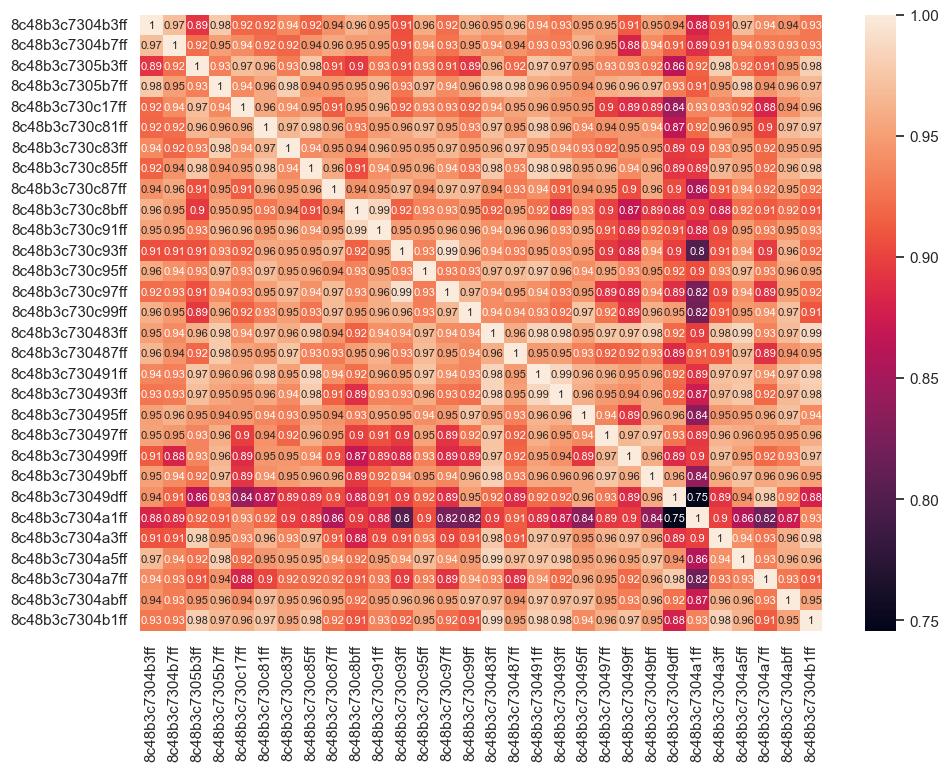

In [35]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize

number_of_hexes=15
encoded_vectors = encoder_model.predict(X_test)

# Sort by hex name
sorted_indices = np.argsort(hexes_test)
hexes_test = hexes_test[sorted_indices]
y_test = y_test[sorted_indices]
encoded_vectors = encoded_vectors[sorted_indices]
X_test = X_test[sorted_indices]

df_test = pd.DataFrame(encoded_vectors)
df_test = pd.concat([
                     df_test,
                     pd.DataFrame(y_test, columns=['y'])
                     ], axis=1)

print(encoded_vectors.shape)
print(y_test.shape)

df_sample_positive = df_test.loc[df_test['y'] == 1].head(number_of_hexes).drop('y', axis=1)
df_sample_negative = df_test.loc[df_test['y'] == 0].head(number_of_hexes).drop('y', axis=1)
df_subsample = pd.concat([df_sample_positive, df_sample_negative])
df_classes = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))
df_labels = np.concatenate((hexes_test[df_test['y'] == 1][0:number_of_hexes], hexes_test[df_test['y'] == 0][0:number_of_hexes]))



similarities = cosine_similarity(df_subsample.to_numpy())


print('Avg Positive Similarity: ', np.average(similarities[0:number_of_hexes, 0:number_of_hexes]))
print('Avg Negative Similarity: ', np.average(similarities[number_of_hexes:number_of_hexes*2, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity P-N: ', np.average(similarities[0:number_of_hexes, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity N-P: ', np.average(similarities[number_of_hexes:number_of_hexes*2, 0:number_of_hexes]))

sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

h = '8c48b3c7304b7ff'
neighbors = np.array(list(h3.k_ring(h, 2)))
neighbors = np.sort(neighbors)

index = hexes_test == h
encoded_hex = encoded_vectors[index]

encoded_neighbors = np.empty((0, 0))

# O PROBLEMA POTENCIALMENTE ESTÁ AQUI!!!!
for n in neighbors:
    indices = np.isin(hexes_test, n)
    if np.sum(indices) > 0:
        encoded_neighbors = np.append(encoded_neighbors, encoded_vectors[indices])
    else:
        encoded_neighbors = np.append(encoded_neighbors, [np.zeros(shape=(1, width))])

encoded_neighbors = encoded_neighbors.reshape((int(encoded_neighbors.shape[0]/width), width))

similarities = cosine_similarity(encoded_hex, encoded_neighbors)
print(similarities)
print(neighbors)
print(h)
print('encoded_neighbors[1]', encoded_neighbors[1])
print('encoded_neighbors[1]', encoded_neighbors[1])

In [36]:
df_classes = pd.DataFrame(similarities[np.where(neighbors == '8c48b3c7304b7ff')[0][0]], columns=['label'])
df_hexes = pd.DataFrame(neighbors, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    #print(row)
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=str(row['hex']),geo_json=True)]}
    
    if row['label'] > 0.95:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'black', 'weight': 0.5})
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})

    folium.Popup(str(row['hex']) + ' ' + str(row['label'])).add_to(geo_j)
    geo_j.add_to(m)

m

IndexError: index 4 is out of bounds for axis 0 with size 1

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

number_of_hexes= 10

df_test = pd.DataFrame(hexes_test)
df_test = pd.concat([
                     df_test,
                     pd.DataFrame(y_test, columns=['y'])
                     ], axis=1)

df_sample_positive = df_test.loc[df_test['y'] == 1].head(number_of_hexes)
df_sample_negative = df_test.loc[df_test['y'] == 0].head(number_of_hexes)
df_subsample = pd.concat([df_sample_positive, df_sample_negative])
df_labels = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))

#df_subsample_norm = tf.math.l2_normalize(df_subsample, axis=1)
#similarities = tf.matmul(df_subsample_norm, df_subsample_norm, transpose_b=True)
#sns.heatmap(similarities.numpy(), xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )


similarities = cosine_similarity(df_subsample.to_numpy())

print('Avg Positive Similarity: ', np.average(similarities[0:number_of_hexes, 0:number_of_hexes]))
print('Avg Negative Similarity: ', np.average(similarities[number_of_hexes:number_of_hexes*2, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity P-N: ', np.average(similarities[0:number_of_hexes, number_of_hexes:number_of_hexes*2]))
print('Avg Disimilarity N-P: ', np.average(similarities[number_of_hexes:number_of_hexes*2, 0:number_of_hexes]))

sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

In [ ]:
df_classes = pd.DataFrame(neighbors, columns=['label'])
df_hexes = pd.DataFrame(neighbors, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
       
    folium.Popup(str(similarities[0][index])).add_to(geo_j)
    geo_j.add_to(m)

m

## Finetuning model

In [ ]:
# Supervised finetuning of the pretrained encoder
finetuning_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
        layers.Dense(1, activation='sigmoid'),
    ],
    name="finetuning_model",
)
finetuning_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

finetuning_history = finetuning_model.fit(
    train_dataset, epochs=num_epochs, validation_data=test_dataset
)
print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)



In [ ]:
# The classification accuracies of the baseline and the pretraining + finetuning process:
def plot_training_curves(pretraining_history, finetuning_history, baseline_history):
    for metric_key, metric_name in zip(["acc", "loss"], ["accuracy", "loss"]):
        plt.figure(figsize=(8, 5), dpi=100)
        plt.plot(
            baseline_history.history[f"val_{metric_key}"], label="supervised baseline"
        )
        plt.plot(
            pretraining_history.history[f"val_p_{metric_key}"],
            label="self-supervised pretraining",
        )
        plt.plot(
            finetuning_history.history[f"val_{metric_key}"],
            label="supervised finetuning",
        )
        plt.legend()
        plt.title(f"Classification {metric_name} during training")
        plt.xlabel("epochs")
        plt.ylabel(f"validation {metric_name}")


plot_training_curves(pretraining_history, finetuning_history, baseline_history)

# Summary Results

In [ ]:
from sklearn.metrics import accuracy_score, recall_score, precision_score,f1_score,matthews_corrcoef
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print(
    "Baseline maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

print(
    "Training maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

print(
    "Finetuning maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)

print('---------------')


output = baseline_model.predict(validation_dataset)
result = np.where(output > 0.5, 1, 0)
print('Baseline Accuracy: {:.2f}%'.format(accuracy_score(y_val, result) * 100))
print('Baseline Recall: {:.2f}%'.format(recall_score(y_val, result) * 100))
print('Baseline Precision: {:.2f}%'.format(precision_score(y_val, result) * 100))
print('Baseline F1: {:.2f}%'.format(f1_score(y_val, result) * 100))
m = confusion_matrix(y_val, result)
print('Baseline Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_val, result))
accuracy_list = (y_val==result.T[0])

print(
      '%.2f'  % (float(accuracy_score(y_val, result))*100) + '\\%&',
      '%.2f' % float(f1_score(y_val, result, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, result, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, result, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_val, result) + '\\\\',
     )

output = finetuning_model.predict(validation_dataset)
result = np.where(output > 0.5, 1, 0)

print('Contrastive Accuracy: {:.2f}%'.format(accuracy_score(y_val, result) * 100))
print('Contrastive Recall: {:.2f}%'.format(recall_score(y_val, result) * 100))
print('Contrastive Precision: {:.2f}%'.format(precision_score(y_val, result) * 100))
print('Contrastive F1: {:.2f}%'.format(f1_score(y_val, result) * 100))
m = confusion_matrix(y_val, result)
print('Contrastive Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_val, result))
accuracy_list = (y_val==result.T[0])

print(
      '%.2f'  % (float(accuracy_score(y_val, result))*100) + '\\%&',
      '%.2f' % float(f1_score(y_val, result, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, result, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, result, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_val, result) + '\\\\',
     )

In [ ]:
print(f1_score(y_val, result, pos_label=0))
print(f1_score(y_val, result, pos_label=1))
print(f1_score(y_val, result, average=None))
print(f1_score(y_val, result, average='binary'))
print(f1_score(y_val, result, average='weighted'))

In [ ]:
output = finetuning_model.predict(validation_dataset)
result = np.where(output > 0.5, 1, 0)

df_classes = pd.DataFrame(result, columns=['label'])
df_hexes = pd.DataFrame(hexes_val, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if accuracy_list[index] == True:
        if row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
        elif row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    else:
        if result[index] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'green', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'red', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

In [ ]:
print(test_dataset)

In [ ]:
output = finetuning_model.predict(test_dataset)
result = np.where(output > 0.5, 1, 0)

df_classes = pd.DataFrame(result, columns=['label'])
df_hexes = pd.DataFrame(hexes_test, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if accuracy_list[index] == True:
        if row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
        elif row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    else:
        if result[index] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'green', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'red', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

In [ ]:
import numpy as np
import rasterio as rio
from rasterio.plot import show
import matplotlib.pyplot as plt

print(np.__version__)
print(rio.__version__)

#elhas_raster = rio.open("D:\\sentinel2\\S2A_MSIL1C_20230305T000221_N0509_R030_T56JKR_20230305T010015.SAFE\\GRANULE\\L1C_T56JKR_A040210_20230305T000218\\IMG_DATA\\T56JKR_20230305T000221_TCI.jp2")
elhas_raster = rio.open("D:\\sentinel2\\allbands.tif")
print(elhas_raster.meta)

# Read, enhance and show the image
elhas_arr = elhas_raster.read() # read the opened image
vmin, vmax = np.nanpercentile(elhas_arr, (5,95))  # 5-95% contrast stretch
# show the enhanced image
plt.figure(figsize=[20,20])
show(elhas_raster, cmap='gray', vmin=vmin, vmax=vmax)
plt.show()

In [ ]:
ds = full_dataset
hexes, y = np.hsplit(labels_and_hexes, 2)
y = [int(x) for x in y]

#y = np.concatenate((y_train, y_test, y_val), axis=0)
#hexes = np.concatenate((hexes_train, hexes_test, hexes_val), axis=0)

output = finetuning_model.predict(ds)
result = np.where(output > 0.5, 1, 0)

print(accuracy_score(y, result))
ConfusionMatrixDisplay(confusion_matrix(y, result)).plot()
matrix = confusion_matrix(y, result)
print(matrix.diagonal()/matrix.sum(axis=1))

accuracy_list = (y==result.T[0])

df_classes = pd.DataFrame(result, columns=['label'])
df_hexes = pd.DataFrame(hexes, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    # if predicted the correct label
    if accuracy_list[index] == True: 
        if row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
            folium.Popup(
                "<a href='http://127.0.0.1:5000/?action=false_negatives&hex=" + str(row['hex']) + "' target='_blank'>False_negative</a><br/><br/>" +
                "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
                ).add_to(geo_j)
        elif row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
            folium.Popup(
                "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
                ).add_to(geo_j)
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        #folium.Popup(str(row['hex'])).add_to(geo_j)
    else:
        # if predicted that it is a field but it is not then fill blue and line green
        if result[index] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'green', 'weight': 0.5})
            folium.Popup(
                "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
                ).add_to(geo_j)
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'red', 'weight': 0.5})
            folium.Popup(
                "<a href='http://127.0.0.1:5000/?action=drop_list&hex=" + str(row['hex']) + "' target='_blank'>Drop</a><br/>" 
                ).add_to(geo_j)
        #folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

#m.save("index.html")

m

In [ ]:
# create an empty array with same dimension and data type
print(elhas_raster.height, elhas_raster.width, elhas_raster.count)
imgxyb = np.empty((elhas_raster.height, elhas_raster.width, elhas_raster.count), elhas_raster.meta['dtype'])
# loop through the raster's bands to fill the empty array
for band in range(imgxyb.shape[2]):
    imgxyb[:,:,band] = elhas_raster.read(band+1)   


In [ ]:
print(imgxyb.shape)
print(imgxyb[8000:10000,8000:10000,2:5].shape)

imgxyb = imgxyb.astype('float64')

print(imgxyb[:,:,1].max())
print(imgxyb[:,:,2].max())
print(imgxyb[:,:,3].max())


b2 = (imgxyb[9000:10900,9000:10900,2] - imgxyb[:,:,2].min()) / (imgxyb[:,:,2].max() - imgxyb[:,:,2].min())
b3 = (imgxyb[9000:10900,9000:10900,3] - imgxyb[:,:,3].min()) / (imgxyb[:,:,3].max() - imgxyb[:,:,3].min())
b4 = (imgxyb[9000:10900,9000:10900,4] - imgxyb[:,:,4].min()) / (imgxyb[:,:,4].max() - imgxyb[:,:,4].min())

b2 = (b2 - b2.min()) / (b2.max() - b2.min())
b3 = (b3 - b3.min()) / (b3.max() - b3.min())
b4 = (b4 - b4.min()) / (b4.max() - b4.min())

print(b2[9000:9010, 9000:9010])



rgb = np.dstack((b2,b3,b4)).T

print(rgb.shape)

#plt.imshow(rgb)

#show(rgb, cmap='gray', vmin=vmin, vmax=vmax)
show(rgb)
#plt.show()

In [ ]:
print(imgxyb.shape)

#print(imgxyb[10970][10000:10100])

<a id='graphbased_segmentation'></a>

# 3. Graph-based segmentation

<div>
<img border="5px" src="../res/graphbasedsegmentation.png" width="1000"/>
</div>

In [ ]:
import networkx as nx
import random

N = 8
G=nx.grid_2d_graph(N,N, periodic=False)


edge_colors = []
for a,b in G.edges():
    weight = random.randint(1,100) / 100
    G[a][b]['weight'] = weight
    if weight > 0.5:
        edge_colors.append('green')
    else:
        edge_colors.append('red')


pos = dict( (n, n) for n in G.nodes() )
labels = dict( ((i, j), str(i) + ',' +str(j )) for i, j in G.nodes() )

nx.draw_networkx(G,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 labels=labels,
                 node_shape='s',
                 edge_color=edge_colors,
                 node_size=800,
                 node_color="green",
                 style="solid",
                )

labels = nx.get_edge_attributes(G,'weight')


for a,b in labels:
    labels[(a,b)] = round(labels[(a,b)],1)

nx.draw_networkx_edge_labels(G,pos,edge_labels=labels, font_size=6)
plt.axis('off')
plt.show()

In [ ]:
threshold = 0.5

for a,b in G.edges():
    if G[a][b]['weight'] < threshold:
        G.remove_edge(a,b)

In [ ]:
nx.draw_networkx(G,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 #labels=labels,
                 node_shape='H',
                 node_size=800,
                 node_color="green",
                 style="solid",
                )

plt.axis('off')
plt.show()

In [ ]:
from networkx.algorithms import community

# perform connected component analysis
#components = list(community.greedy_modularity_communities(G))

S = [G.subgraph(c).copy() for c in nx.connected_components(G)]

for idx,H in enumerate(S):
    random_color = list(np.random.choice(range(100,256), size=3)/256)
    cmap = [random_color] * len(H.nodes())
    
    labels = {}
    for n in H.nodes():
        labels[n] = "C" + str(idx)
    
    nx.draw_networkx(H,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 labels=labels,
                 node_shape='H',
                 node_size=1800,
                 node_color=cmap,
                 style="solid",
                )
plt.axis('off')
plt.show()

# End of Notebook